<a href="https://colab.research.google.com/github/SmittyB00p/vcrr6wP8OlqUPGrI/blob/main/text_extraction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Text Extraction from Images

In [ ]:
!pip install pillow_heif
!pip install -U bitsandbytes peft flash
!pip install speechbrain
# !pip install -U flash-attn --no-build-isolation

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 54.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.1/76.1 MB 26.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 411.1/411.1 kB 21.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 81.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 78.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 47.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 36.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2

In [ ]:
import os
import sys
import requests
from pathlib import Path
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from matplotlib import image as mpimg
from PIL import Image
from pillow_heif import register_heif_opener

from transformers import BitsAndBytesConfig

import torch
import torchvision
import torch.nn as nn
from torch.nn import functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
import torch.backends.cudnn as cudnn
from torchvision import datasets
from torchvision.io import decode_image
from torchvision.transforms import v2
from transformers import AutoProcessor, AutoModelForVision2Seq

In [ ]:
## images for testing the Idefics Model
path_to_images = str(Path(os.getcwd()+'/drive/MyDrive/extraction images'))
non_string_path_to_images = Path(os.getcwd()+'/drive/MyDrive/extraction images')

images_list = os.listdir(path_to_images)

## images from MonReader Project
path_to_training_images = str(Path(os.getcwd()+'/drive/MyDrive/images/training/notflip'))
non_string_path_to_training_images = Path(os.getcwd()+'/drive/MyDrive/images/training/notflip')

training_images_list = os.listdir(path_to_training_images)

In [ ]:
## gets random image from the MonReader images
random_image = np.random.choice(training_images_list)

In [ ]:
def get_random_image(path_to_training_images:str):
  '''
  -- Parameters --
  path_to_training_images: path to images folder

  -- Returns --
  cropped and resized image

  '''
  random_image = np.random.choice(os.listdir(path_to_training_images))

  img = Image.open(path_to_training_images+'/'+random_image)
  # print(f"Shape of image: {np.array(Image.open(path_to_training_images+'/'+image)).shape}\n")

  img = img.crop((50, 350, 1100, 1500))
  img = img.resize((980, 980))
  plt.figure(figsize=(12,12))
  plt.imshow(img)
  plt.show()

  # print(f"Shape of image resized image: {np.array(img).shape}")


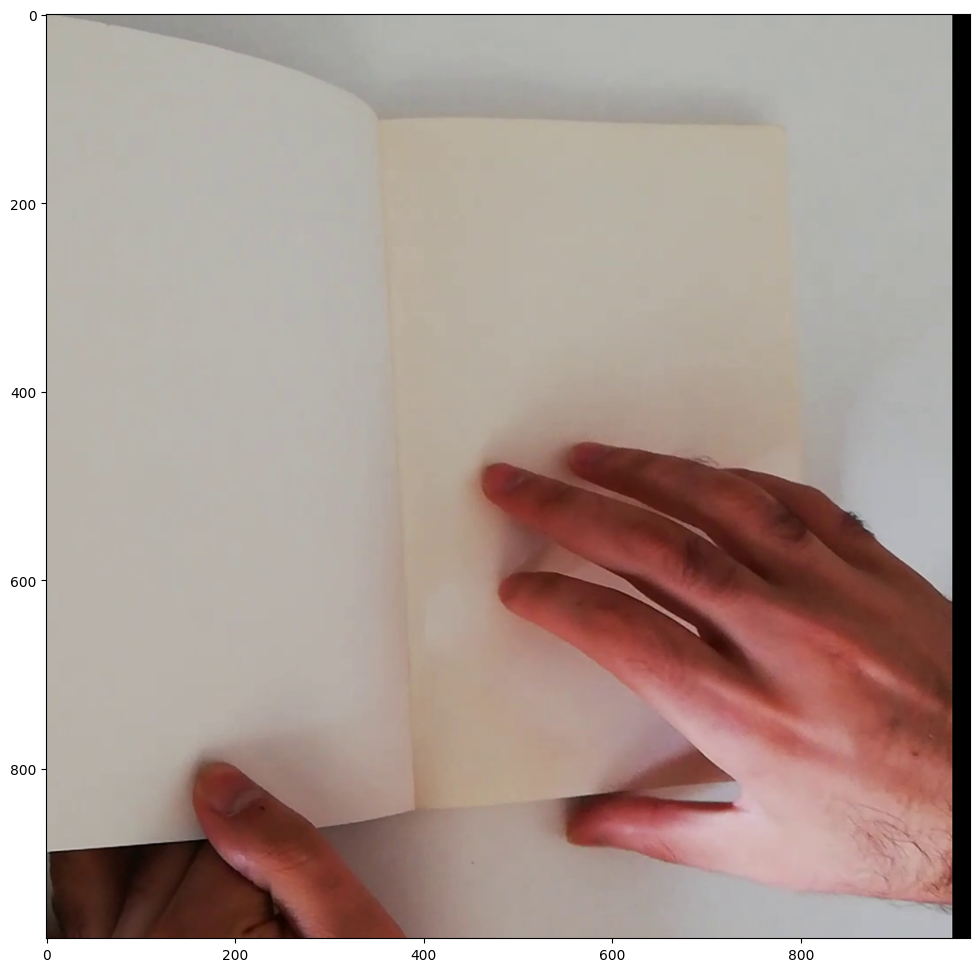

In [ ]:
get_random_image(path_to_training_images)

In [ ]:
for image in images_list:
  print(image)

IMG_1250.jpg
IMG_1253.jpg
IMG_1251.jpg
IMG_1252.jpg
IMG_1243.jpg
IMG_1248.jpg
IMG_1244.jpg
IMG_1254.jpg
IMG_1249.jpg
IMG_1247.jpg
IMG_1257.jpg
.ipynb_checkpoints
IMG_1250_resize.jpg
IMG_1253_resize.jpg
IMG_1251_resize.jpg
IMG_1252_resize.jpg
IMG_1243_resize.jpg
IMG_1248_resize.jpg
IMG_1244_resize.jpg
IMG_1254_resize.jpg
IMG_1249_resize.jpg
IMG_1247_resize.jpg
IMG_1257_resize.jpg


In [ ]:
## function for converting images from HEIF to JPG

def heif_to_jpg(image_path, remove=False):
  '''
  -- Parameters --
  image_path: PoxisPath to folder containing images to be converted
  remove: set to True if you want to remove the old HEIF images. Default = False

  -- Returns --
  saves new images to image_path

  '''

  register_heif_opener()

  for image in image_path.rglob("*.[hH][eE][iI][Cc]"):
    pillow_heif_image = Image.open(image)

    new_image = f"{image.stem}.jpg"

    print(f"New image '{new_image}' being saved to {image_path}")
    pillow_heif_image.convert('RGB').save(f"drive/MyDrive/extraction images/{new_image}")

    if remove == True:
      os.remove(image)

In [ ]:
# heif_to_jpg(Path(os.getcwd()+'/drive/MyDrive/extraction images'), remove=True)

In [ ]:
# for image in os.listdir(path_to_images):
#   if image.endswith('.jpg'):
#     image = mpimg.imread(path_to_images+'/'+image)
#     plt.figure(figsize=(12,12))
#     plt.imshow(image)
#     plt.show()

In [ ]:
## resize images for modeling

def resize_image(image_path=str(), size=int()):
  '''
  -- Parameters --
  image_path: path to folder containing images to be resized
  size: size to resize images to. The image will be square e.g. (size x size)

  -- Returns --
  saves new image to image_path
  '''

  for image in os.listdir(image_path):
    if image.endswith('.jpg'): ## this will have to get fixed to make sure anything between the _ and .jpg gets excluded
      print(f"Image name: {image}")
      img = Image.open(image_path+'/'+image)
      img = img.resize((size, size))
      img.save(f"drive/MyDrive/extraction images/{image[:8]}_resize.jpg")

In [ ]:
# resize_image(path_to_images, size=980)

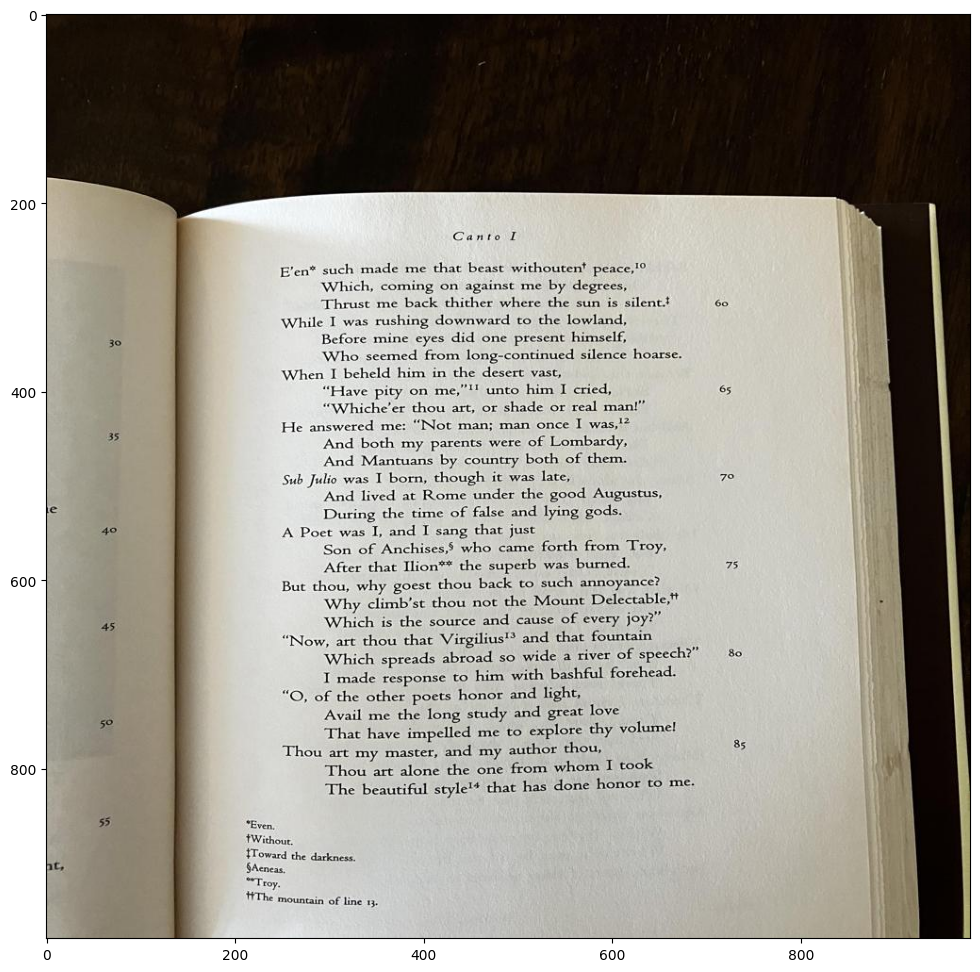

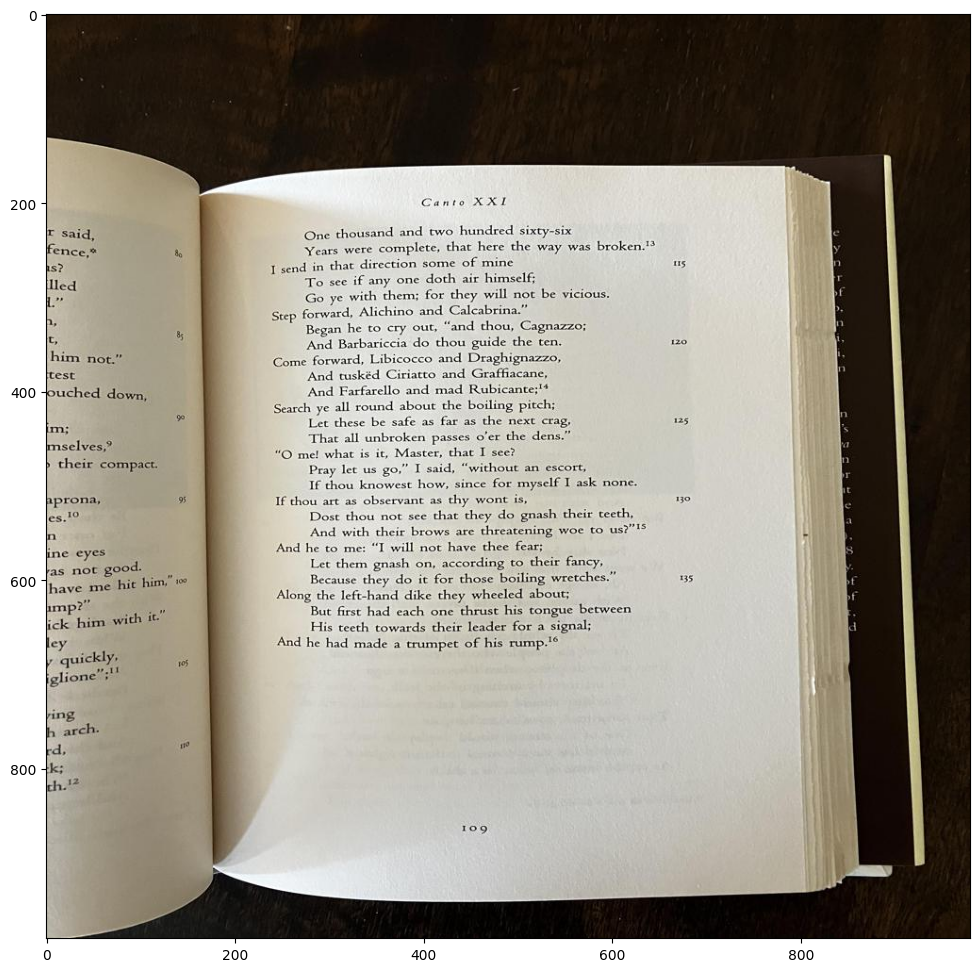

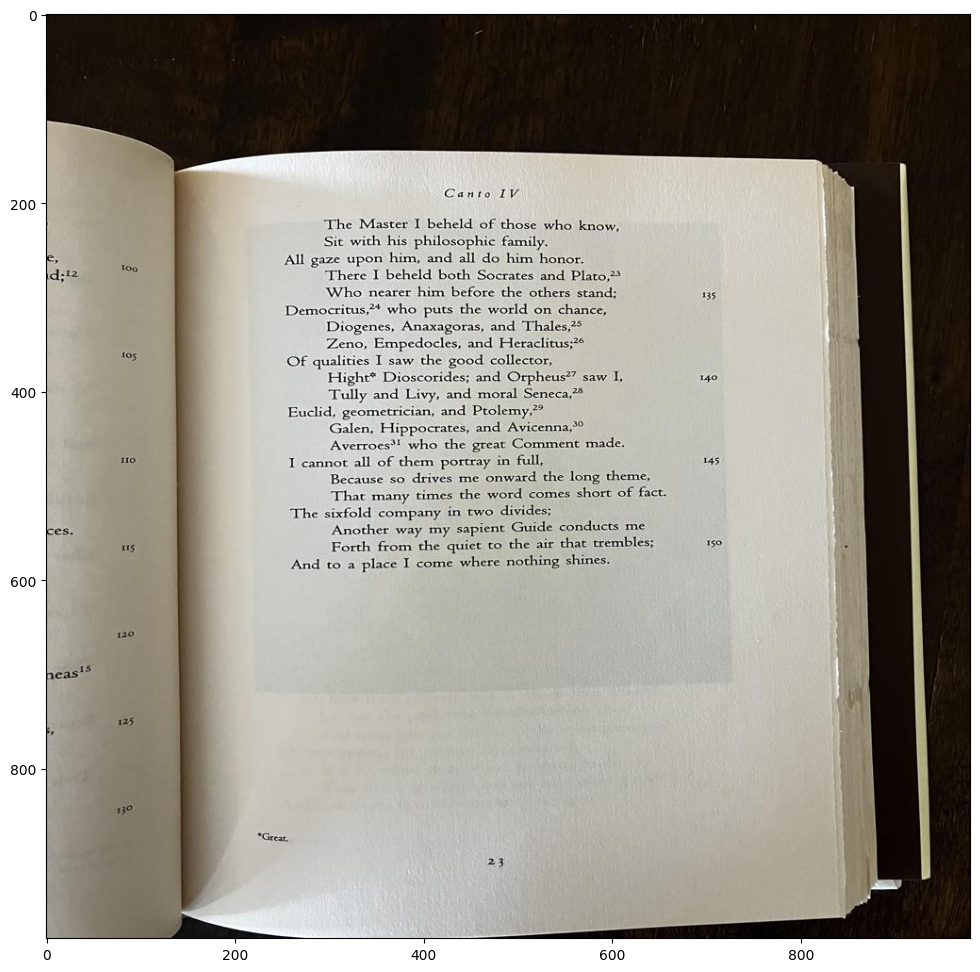

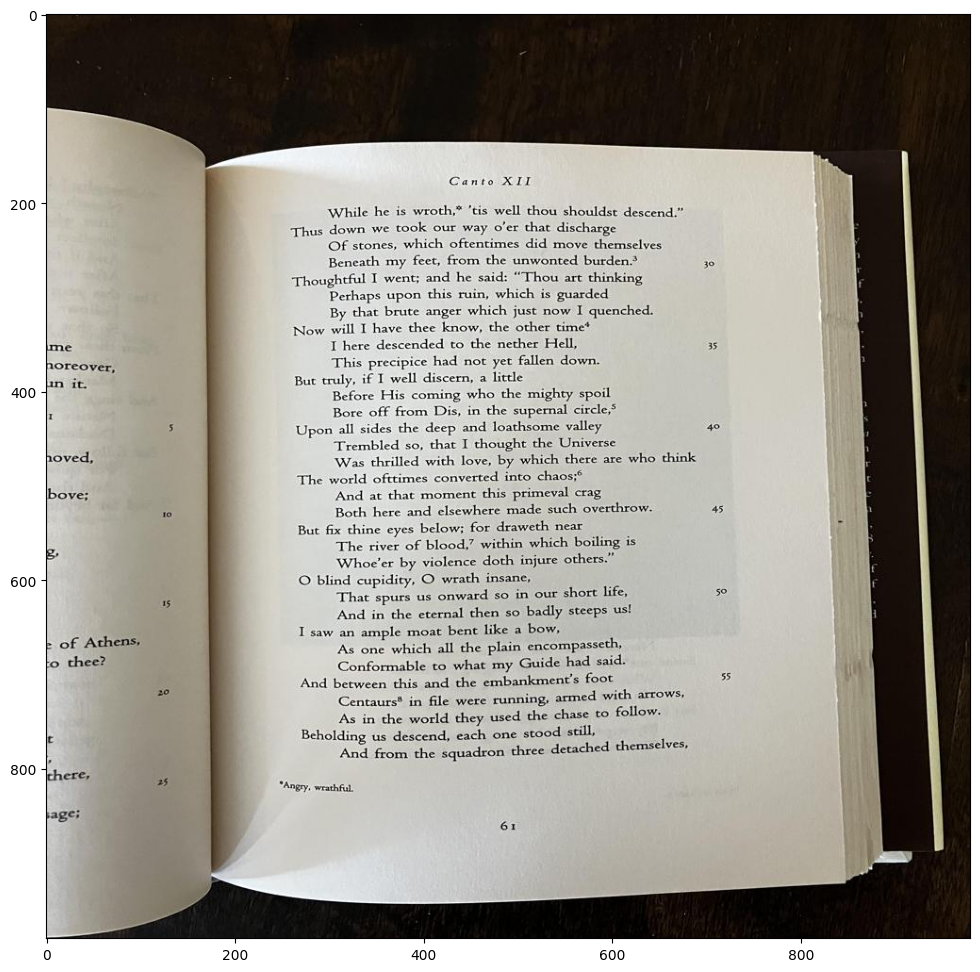

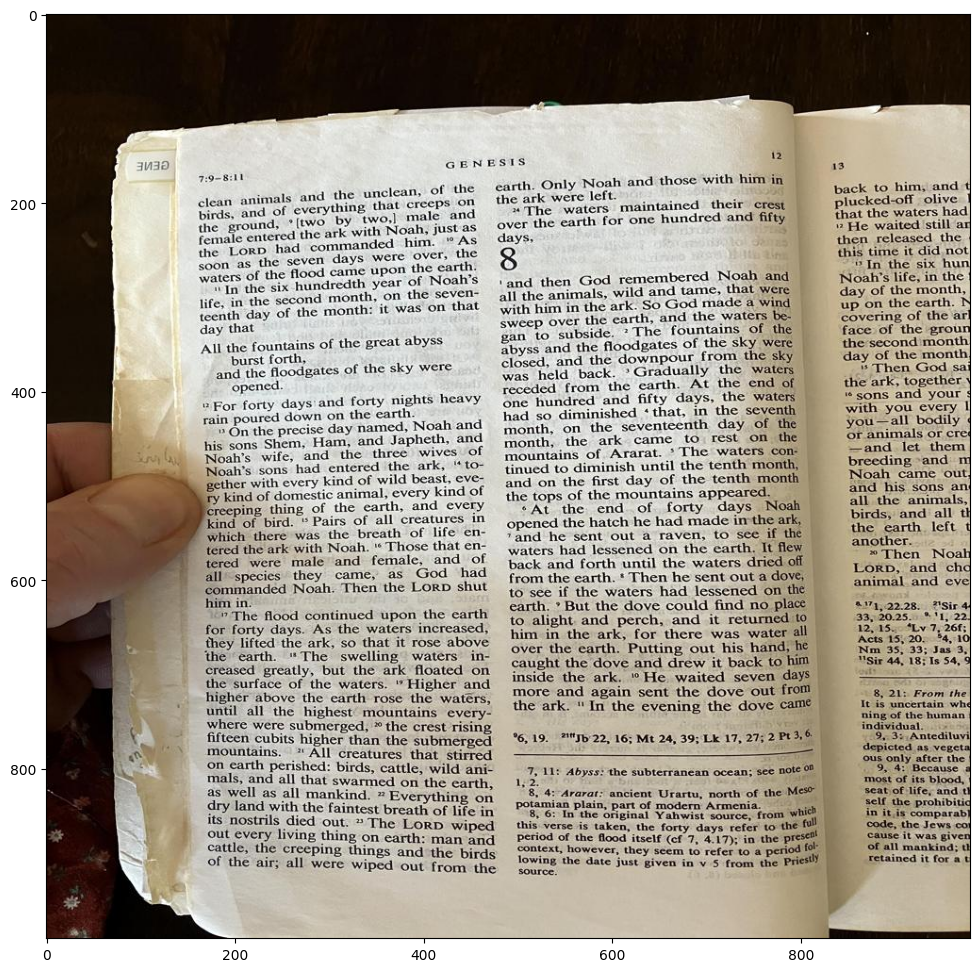

...

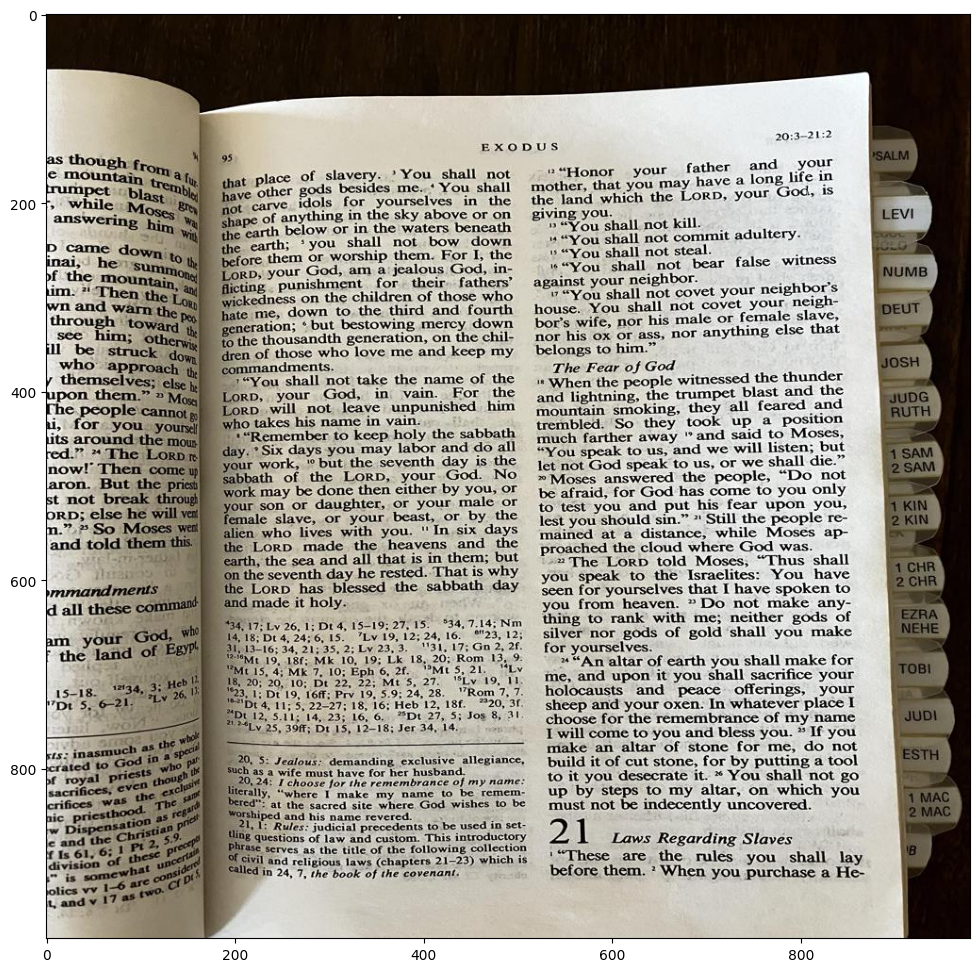

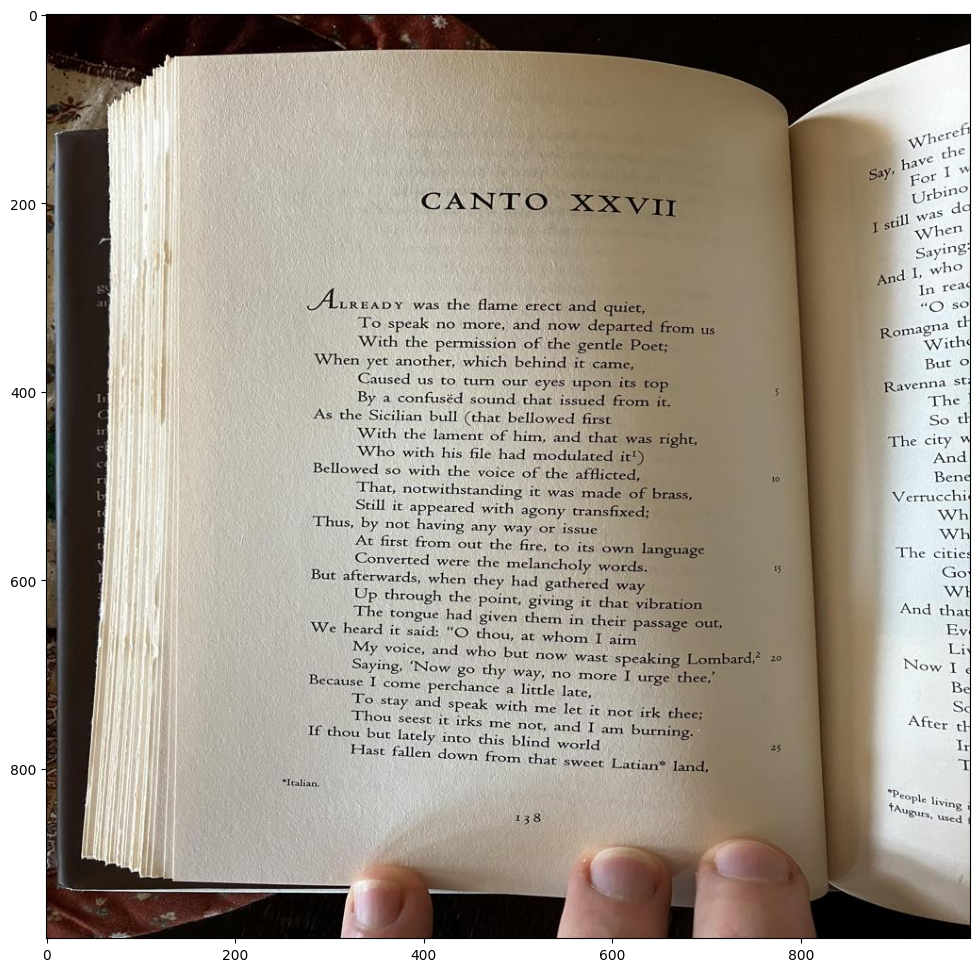

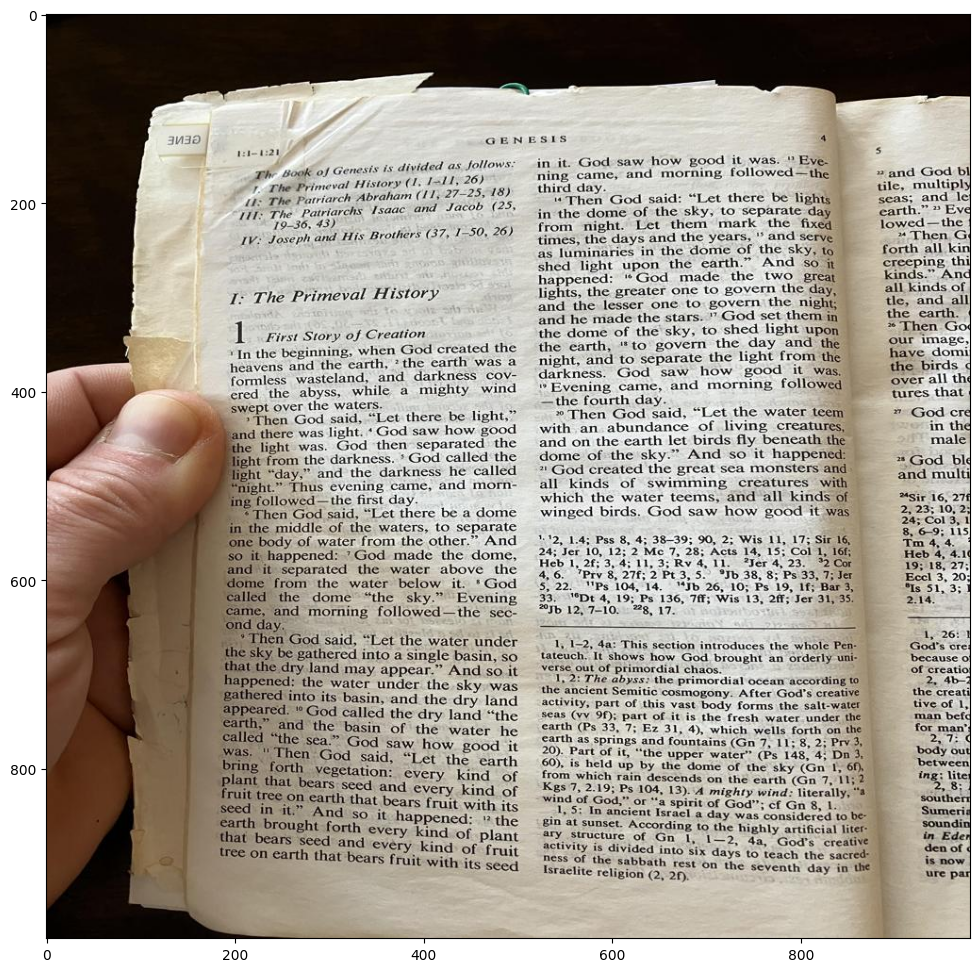

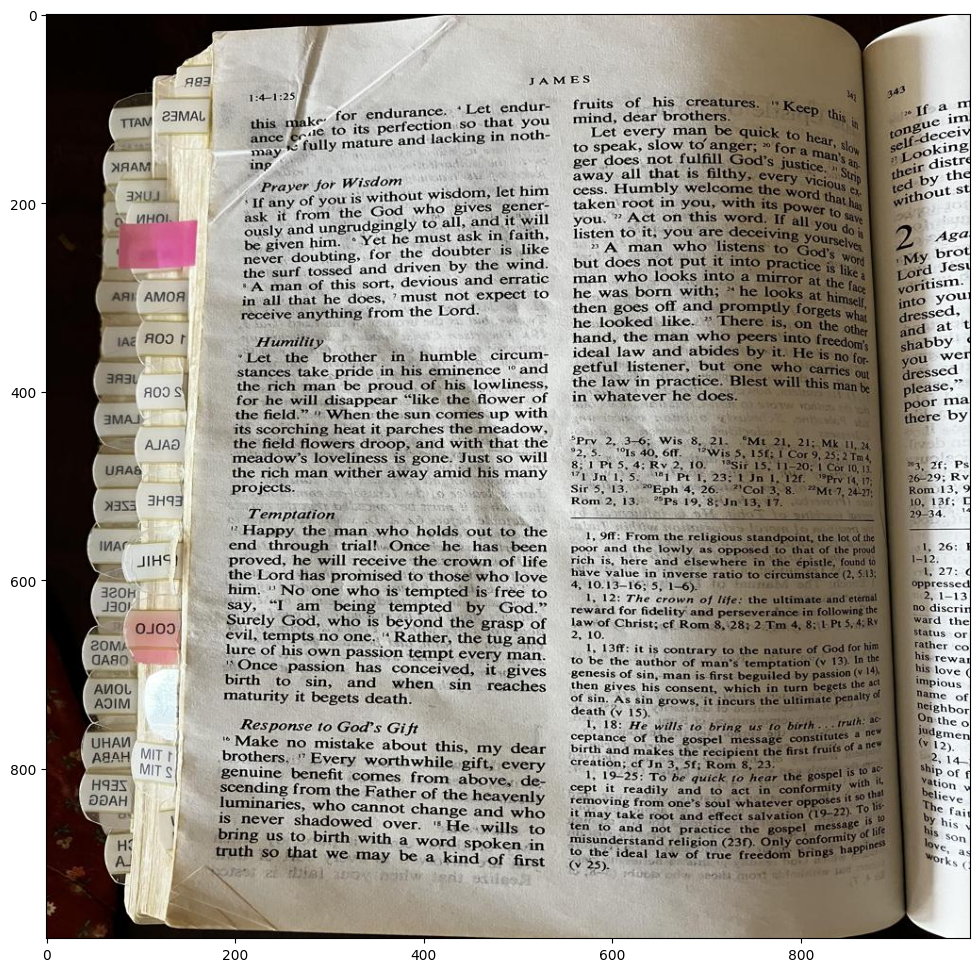

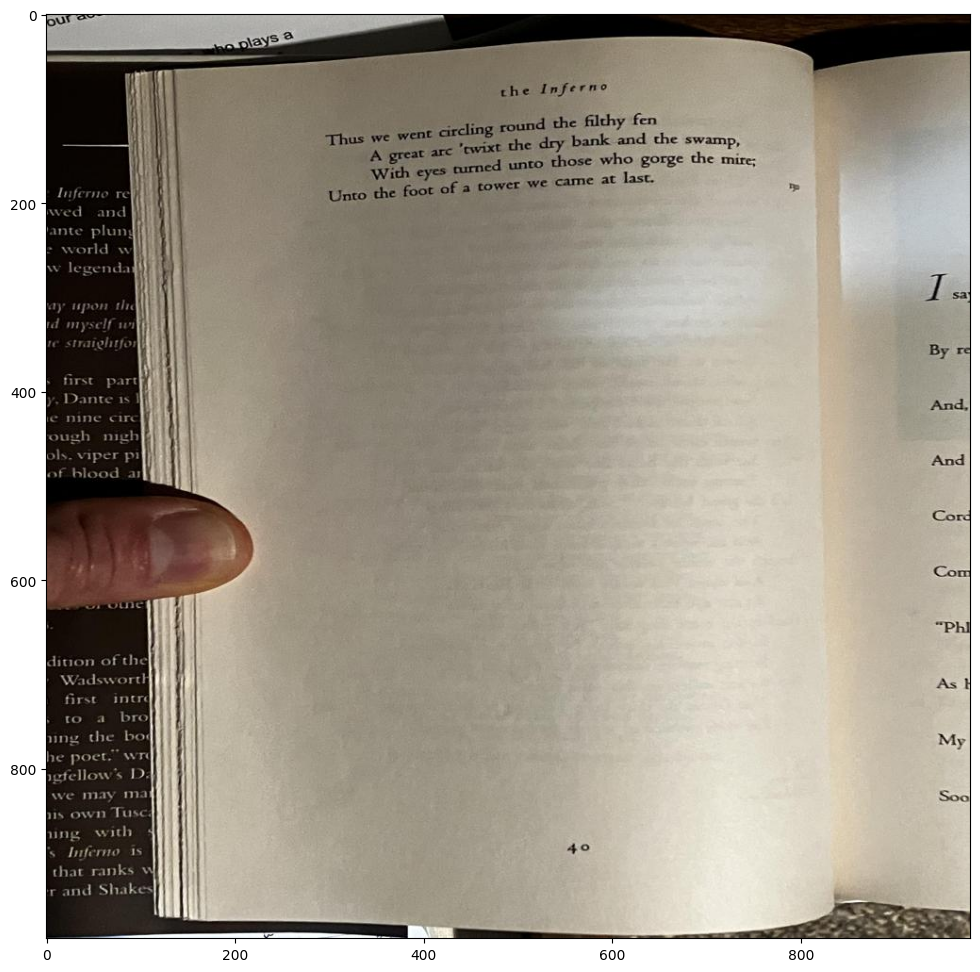

In [ ]:
for image in os.listdir(path_to_images):
  if image.endswith('_resize.jpg'):
    img = Image.open(path_to_images+'/'+image)
    plt.figure(figsize=(12,12))
    plt.imshow(img)
    plt.show()

In [ ]:
resized_images = [Image.open(path_to_images+'/'+image) for image in images_list if image.endswith('_resize.jpg')]

In [ ]:
genesis1 = resized_images[8]
exodus20 = resized_images[6]
canto1 = resized_images[0]

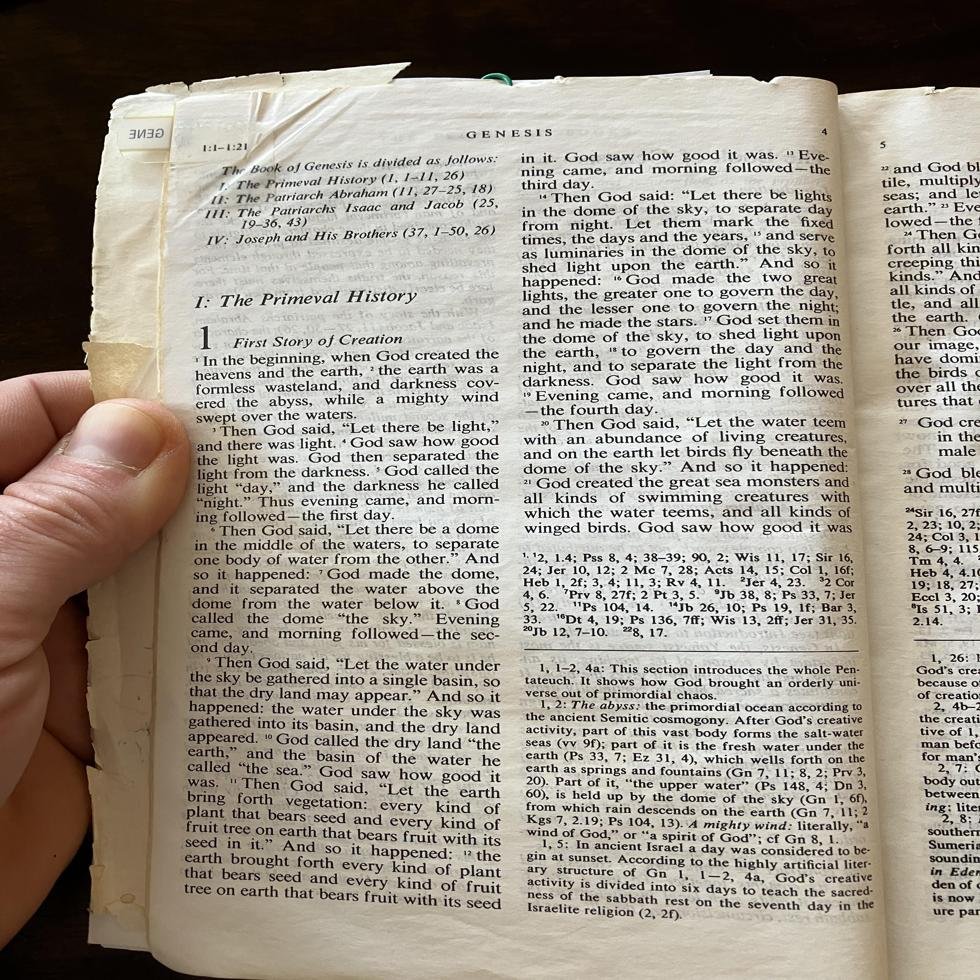

In [ ]:
genesis1

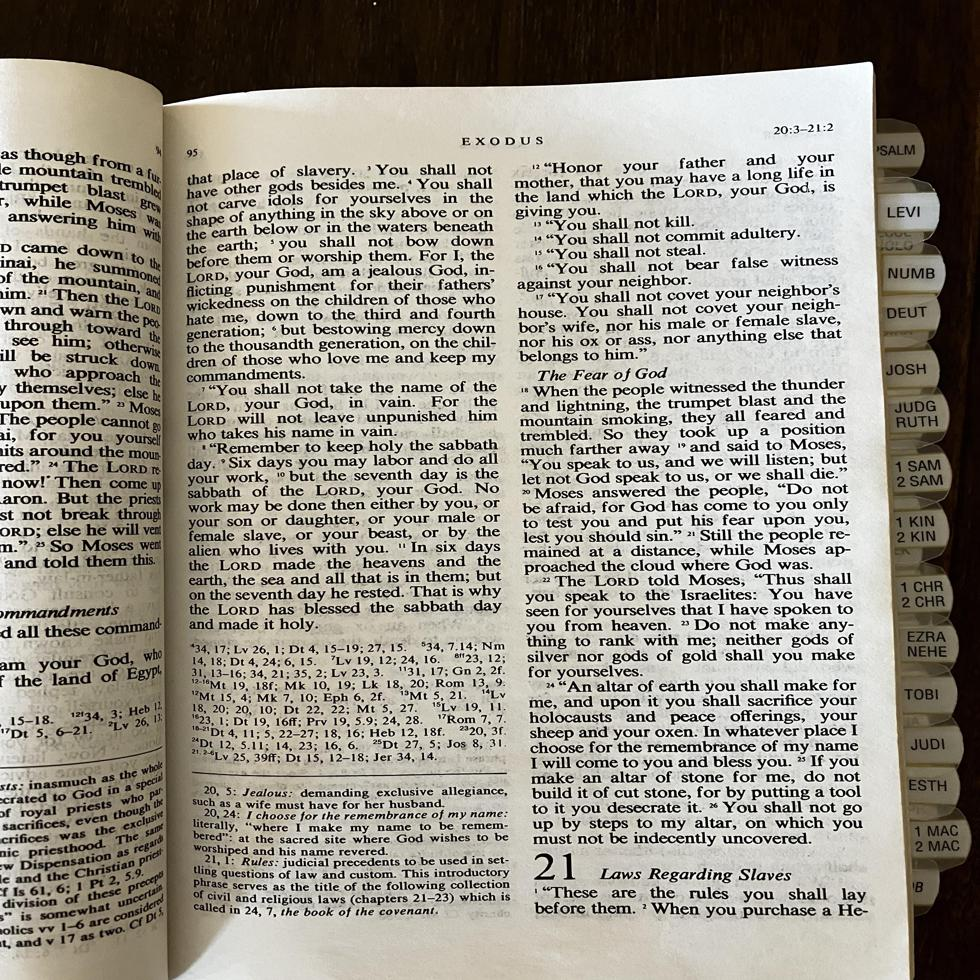

In [ ]:
exodus20

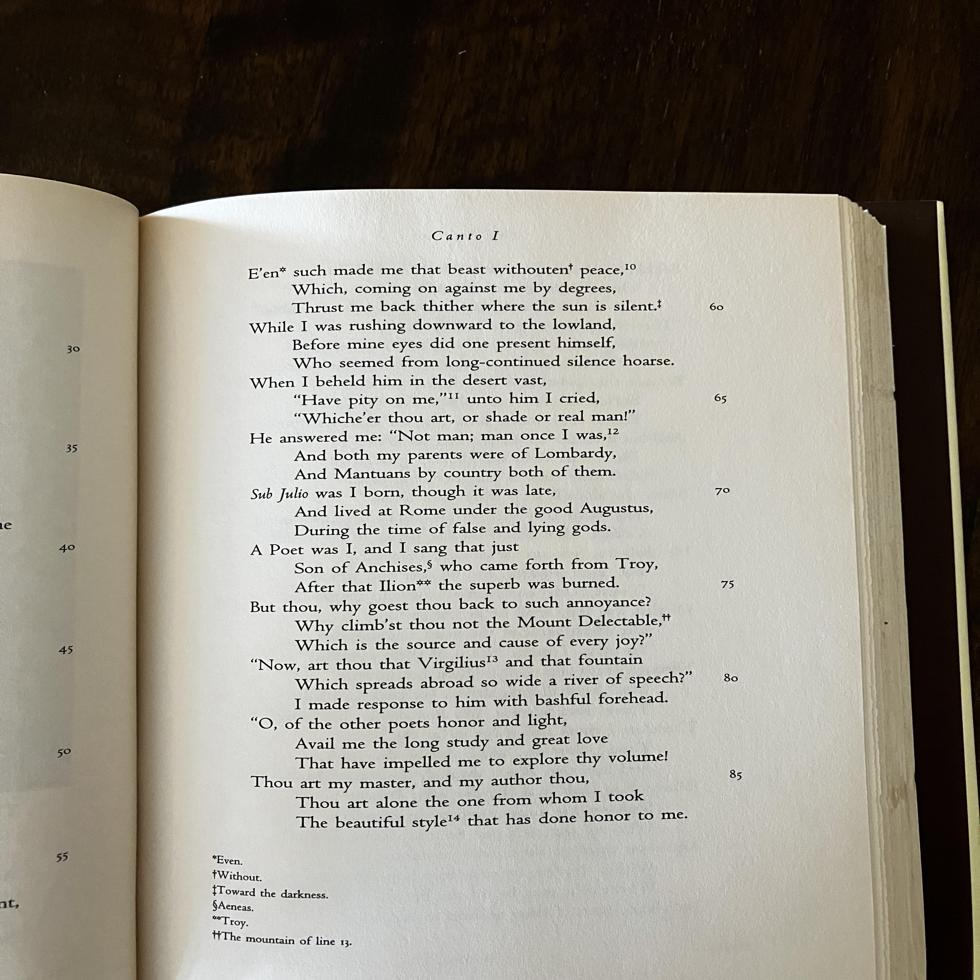

In [ ]:
canto1

## Idefics3
https://huggingface.co/docs/transformers/en/model_doc/idefics3

In [ ]:
## load in model and processor if not saved onto disk

if not os.path.exists("drive/MyDrive/project_4/idefics3_model/IDEFICS3_bookOCR_ft_tutorial"):
  from peft import LoraConfig

  processor = AutoProcessor.from_pretrained("HuggingFaceM4/Idefics3-8B-Llama3")
  model = AutoModelForVision2Seq.from_pretrained("HuggingFaceM4/Idefics3-8B-Llama3",
                                                torch_dtype=torch.bfloat16,
                                                #  attn_implementation="flash_attention_2",
                                                device_map="auto")

  lora_config = LoraConfig(
          r=8,
          lora_alpha=8,
          lora_dropout=0.1,
          target_modules='.*(text_model|modality_projection|perceiver_resampler).*(down_proj|gate_proj|up_proj|k_proj|q_proj|v_proj|o_proj).*$',
          use_dora=False,
          init_lora_weights="gaussian"
      )

  model.add_adapter(lora_config)
  model.enable_adapters()

  model.save_pretrained("drive/MyDrive/project_4/idefics3_model/IDEFICS3_bookOCR_ft_tutorial")
  processor.save_pretrained("drive/MyDrive/project_4/idefics3_processor/IDEFICS3_bookOCR_ft_tutorial")

else:
  ## loads saved model and processor
  model = AutoModelForVision2Seq.from_pretrained("drive/MyDrive/project_4/idefics3_model/IDEFICS3_bookOCR_ft_tutorial")
  processor = AutoProcessor.from_pretrained("drive/MyDrive/project_4/idefics3_processor/IDEFICS3_bookOCR_ft_tutorial")

config.json:   0%|          | 0.00/7.18k [00:00<?, ?B/s]

model.safetensors.index.json:   0%|          | 0.00/70.6k [00:00<?, ?B/s]

Fetching 4 files:   0%|          | 0/4 [00:00<?, ?it/s]

model-00001-of-00004.safetensors:   0%|          | 0.00/4.97G [00:00<?, ?B/s]

model-00004-of-00004.safetensors:   0%|          | 0.00/2.04G [00:00<?, ?B/s]

model-00002-of-00004.safetensors:   0%|          | 0.00/5.00G [00:00<?, ?B/s]

model-00003-of-00004.safetensors:   0%|          | 0.00/4.92G [00:00<?, ?B/s]

Loading checkpoint shards:   0%|          | 0/4 [00:00<?, ?it/s]

generation_config.json:   0%|          | 0.00/198 [00:00<?, ?B/s]

In [ ]:
os.environ['PYTORCH_CUDA_ALLOC_CONF']='expandable_segments:True'

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

print(os.environ['PYTORCH_CUDA_ALLOC_CONF'])

model.to(device)

expandable_segments:True


Idefics3ForConditionalGeneration(
  (model): Idefics3Model(
    (vision_model): Idefics3VisionTransformer(
      (embeddings): Idefics3VisionEmbeddings(
        (patch_embedding): Conv2d(3, 1152, kernel_size=(14, 14), stride=(14, 14), padding=valid)
        (position_embedding): Embedding(676, 1152)
      )
      (encoder): Idefics3Encoder(
        (layers): ModuleList(
          (0-26): 27 x Idefics3EncoderLayer(
            (self_attn): Idefics3VisionAttention(
              (k_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (v_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (q_proj): Linear(in_features=1152, out_features=1152, bias=True)
              (out_proj): Linear(in_features=1152, out_features=1152, bias=True)
            )
            (layer_norm1): LayerNorm((1152,), eps=1e-06, elementwise_affine=True)
            (mlp): Idefics3VisionMLP(
              (activation_fn): PytorchGELUTanh()
              (fc1): Linear(in_

In [ ]:
messages = [
    {
        "role": "user",
        "content": [
            {"type": "text", "text": "You are given an image of an open book. Your task is to extract the words on the open page. Do not add any additional text. Just the text in the image."},
            {"type": "image"},
            {"type": "text", "text": "Extract the text that is on the page in the image."},
]},
]

text = processor.apply_chat_template(messages, add_generation_prompt=False)
print(text)

<|begin_of_text|>User: You are given an image of an open book. Your task is to extract the words on the open page. Do not add any additional text. Just the text in the image.<image>Extract the text that is on the page in the image.<end_of_utterance>



In [ ]:
prompts = [processor.apply_chat_template([message], add_generation_prompt=True) for message in messages]
images = [genesis1]
inputs = processor(text=prompts, images=images, padding=True, return_tensors="pt").to(model.device)

generated_ids = model.generate(**inputs, max_new_tokens=1000)
generated_texts = processor.batch_decode(generated_ids, skip_special_tokens=True)
generated_texts[0]

'User: You are given an image of an open book. Your task is to extract the words on the open page. Do not add any additional text. Just the text in the image.<image>Extract the text that is on the page in the image.\nAssistant: 1. In the beginning, when God created the earth, the earth was formless and dark, and darkness covered the deep, while a mighty wind swept over the waters. And God said, "Let there be light," and there was light. God saw how good it was. 2. And God separated the light from the darkness. God called the light "day" and the darkness "night." Evening came, and morning followed—the first day. 3. Then God said, "Let there be a vault between the waters above and below, to separate the waters from each other." And so it happened. 4. God called the vault "the sky." Evening came, and morning followed—the second day. 5. Then God said, "Let the waters below the sky be gathered into one place, and let the dry land appear." And so it happened. 6. God called the dry land "eart

In [ ]:
generated_texts[0][226:]

'1. In the beginning, when God created the earth, the earth was formless and dark, and darkness covered the deep, while a mighty wind swept over the waters. And God said, "Let there be light," and there was light. God saw how good it was. 2. And God separated the light from the darkness. God called the light "day" and the darkness "night." Evening came, and morning followed—the first day. 3. Then God said, "Let there be a vault between the waters above and below, to separate the waters from each other." And so it happened. 4. God called the vault "the sky." Evening came, and morning followed—the second day. 5. Then God said, "Let the waters below the sky be gathered into one place, and let the dry land appear." And so it happened. 6. God called the dry land "earth," and the gathering of the waters he called "seas." And God saw how good it was. 7. Then God said, "Let the earth produce vegetation: seed-bearing plants and trees that bear fruit with seed in it, according to their kinds." A

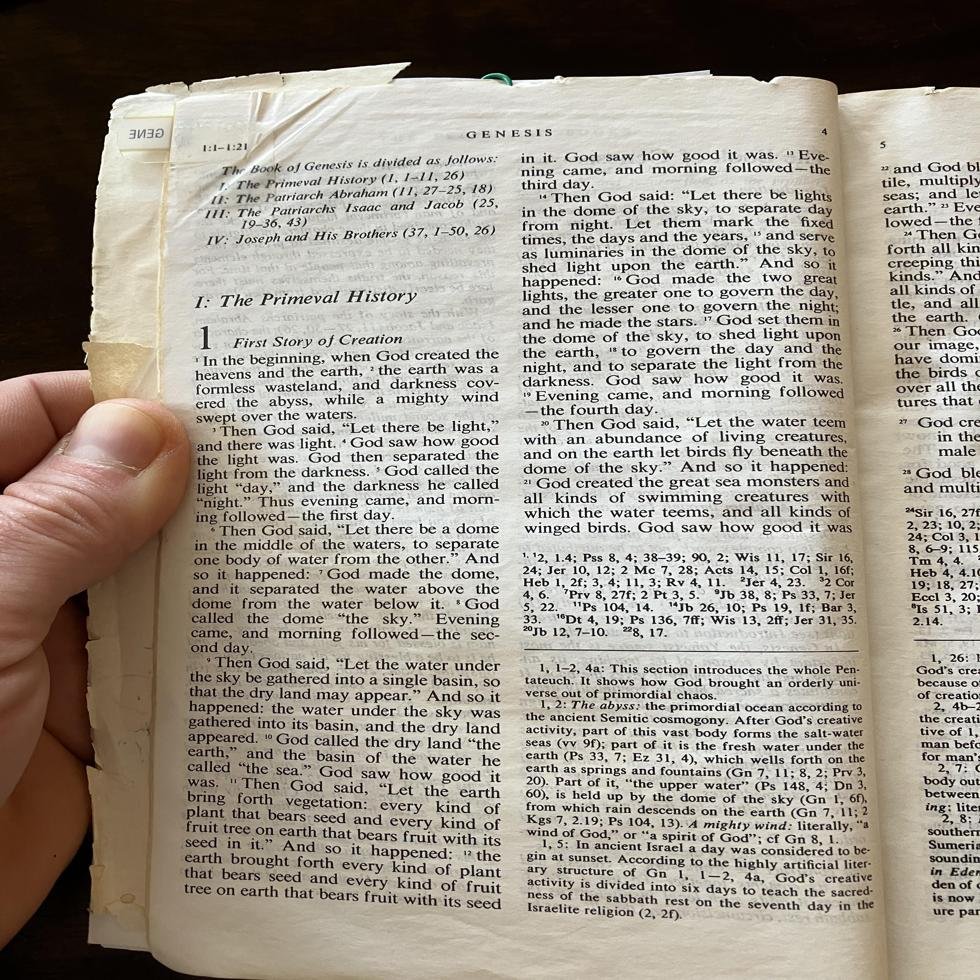

In [ ]:
genesis1

In [ ]:
## ground truth text from Vatican website

with open('drive/MyDrive/genesis_1_text_txt.txt', 'r') as file:
  text = file.read()

print(text)

First Story of Creation

1 In the beginning, when God created the heavens and the earth,
2 the earth was a formless wasteland, and darkness covered the abyss, while a mighty wind swept over the waters.
3 Then God said, "Let there be light," and there was light.
4 God saw how good the light was. God then separated the light from the darkness.
5 God called the light "day," and the darkness he called "night." Thus evening came, and morning followed - the first day.
6 Then God said, "Let there be a dome in the middle of the waters, to separate one body of water from the other." And so it happened:
7 God made the dome, and it separated the water above the dome from the water below it.
8 God called the dome "the sky." Evening came, and morning followed - the second day.
9 Then God said, "Let the water under the sky be gathered into a single basin, so that the dry land may appear." And so it happened: the water under the sky was gathered into its basin, and the dry land appeared.
10 God calle

In [ ]:
genesis1_ground_truth_list = text.split()
genesis1_ground_truth_list[:10]

['First',
 'Story',
 'of',
 'Creation',
 '1',
 'In',
 'the',
 'beginning,',
 'when',
 'God']

In [ ]:
## https://machinelearningmastery.com/calculate-bleu-score-for-text-python/

from nltk.translate.bleu_score import sentence_bleu

genesis_bleu_score_idefics = sentence_bleu([genesis1_ground_truth_list], generated_texts[0][226:].split())
print(f"Idefics model bleu score with Genesis1 image: {round(genesis_bleu_score_idefics, 4)*100}%")

Idefics model bleu score with Genesis1 image: 23.04%


### Test on random MonReader training notflip image

In [ ]:
def text_extraction(image_path:str, image:str, size:int):
  '''
  -- Parameters --
  image_path: path to folder containing images to be resized
  image: image to extract text from
  size: size to resize images to. The image will be square e.g. (size x size)

  -- Returns --
  extracted text from Idefics3 model
  '''

  IMAGES_LIST = os.listdir(image_path)

  ## check to see if image is 'jpg' or something else
  if not image.endswith('.jpg'):
    pass #### this will have to implement the heif_to_jpg function but that right now is not optimal
         #### thankfully for now all the images are jpg

  else:
    IMAGE = Image.open(image_path+'/'+image)
    IMAGE = IMAGE.crop((50, 350, 1000, 1500))
    IMAGE = IMAGE.resize((size, size))
    plt.figure(figsize=(12,12))
    plt.imshow(IMAGE)
    plt.show()

  ## run TRAINED Idefics model

  messages = [
    {
        "role": "user",
        "content": [
            {"type": "text", "text": "You are given an image of an open book. Your task is to extract the words on the open page. Do not add any additional text."},
            {"type": "image"},
            {"type": "text", "text": "Extract the text that is on the page in the image. Do not extrapolate or add any additional text to your repsonse."},
  ]},
  ]

  text = processor.apply_chat_template(messages, add_generation_prompt=False)

  prompts = [processor.apply_chat_template([message], add_generation_prompt=True) for message in messages]
  images = [IMAGE]
  inputs = processor(text=prompts, images=images, padding=True, return_tensors="pt").to(model.device)

  generated_ids = model.generate(**inputs, max_new_tokens=1000)
  generated_texts = processor.batch_decode(generated_ids, skip_special_tokens=True)

  return generated_texts[0]

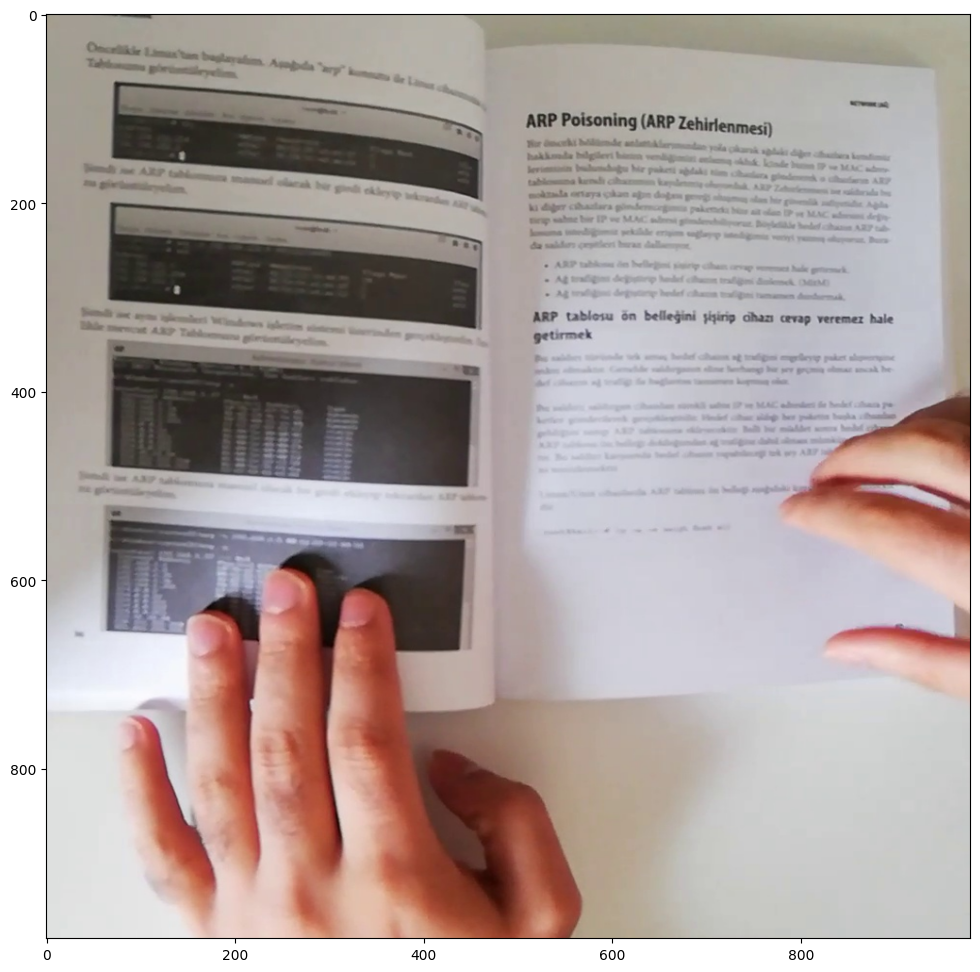

'User: You are given an image of an open book. Your task is to extract the words on the open page. Do not add any additional text.<image>Extract the text that is on the page in the image. Do not extrapolate or add any additional text to your repsonse.\nAssistant: ARP Poisoning (ARP Spoofing).'

In [ ]:
generated_text = text_extraction(path_to_training_images, random_image, size=980)
generated_text

## Gemini 1.5

https://ai.google.dev/gemini-api/docs/text-generation?lang=python

In [ ]:
from google import genai
from google.colab import userdata

### make sure to use your own API key for this line
GEMINI_API_KEY = userdata.get('gemini_api_key')

GEMINI_API_KEY = GEMINI_API_KEY

client = genai.Client(api_key=GEMINI_API_KEY)

image = genesis1

response1 = client.models.generate_content(
    model="gemini-1.5-flash",
    contents=[image, "Extract the text that is on the open page of the image. Do not add any extra text or special characters to your response. If sentences are incomplete, do not extract that text in your response."])

genesis1_response = response1.text
print(genesis1_response)

GENESIS
The Book of Genesis is divided as follows:
I: The Primeval History (1, 1-11, 26)
II: The Patriarch Abraham (11, 27-25, 18)
III: The Patriarchs Isaac and Jacob (25,
19-36, 43)
IV: Joseph and His Brothers (37, 1-50, 26)
I: The Primeval History
1 First Story of Creation
In the beginning, when God created the
heavens and the earth, the earth was a
formless wasteland, and darkness cov-
ered the abyss, while a mighty wind
swept over the waters.
Then God said, "Let there be light,"
and there was light. God saw how good
the light was. God then separated the
light from the darkness. God called the
light "day," and the darkness he called
"night." Thus evening came, and morn-
ing followed—the first day.
Then God said, "Let there be a dome
in the middle of the waters, to separate
one body of water from the other." And
so it happened: God made the dome,
and it separated the water above the
dome from the water below it. God
called the dome "the sky." Evening
came, and morning followed—the se

In [ ]:
genesis1_response

'GENESIS\nThe Book of Genesis is divided as follows:\nI: The Primeval History (1, 1-11, 26)\nII: The Patriarch Abraham (11, 27-25, 18)\nIII: The Patriarchs Isaac and Jacob (25,\n19-36, 43)\nIV: Joseph and His Brothers (37, 1-50, 26)\nI: The Primeval History\n1 First Story of Creation\nIn the beginning, when God created the\nheavens and the earth, the earth was a\nformless wasteland, and darkness cov-\nered the abyss, while a mighty wind\nswept over the waters.\nThen God said, "Let there be light,"\nand there was light. God saw how good\nthe light was. God then separated the\nlight from the darkness. God called the\nlight "day," and the darkness he called\n"night." Thus evening came, and morn-\ning followed—the first day.\nThen God said, "Let there be a dome\nin the middle of the waters, to separate\none body of water from the other." And\nso it happened: God made the dome,\nand it separated the water above the\ndome from the water below it. God\ncalled the dome "the sky." Evening\ncame

In [ ]:
with open('drive/MyDrive/project_4/gemini_genesis_response.txt', 'w') as file:
  file.write(genesis1_response)

In [ ]:
genesis1_list = genesis1_response.split()
genesis1_list[45:-197]

['First',
 'Story',
 'of',
 'Creation',
 'In',
 'the',
 'beginning,',
 'when',
 'God',
 'created',
 'the',
 'heavens',
 'and',
 'the',
 'earth,',
 'the',
 'earth',
 'was',
 'a',
 'formless',
 'wasteland,',
 'and',
 'darkness',
 'cov-',
 'ered',
 'the',
 'abyss,',
 'while',
 'a',
 'mighty',
 'wind',
 'swept',
 'over',
 'the',
 'waters.',
 'Then',
 'God',
 'said,',
 '"Let',
 'there',
 'be',
 'light,"',
 'and',
 'there',
 'was',
 'light.',
 'God',
 'saw',
 'how',
 'good',
 'the',
 'light',
 'was.',
 'God',
 'then',
 'separated',
 'the',
 'light',
 'from',
 'the',
 'darkness.',
 'God',
 'called',
 'the',
 'light',
 '"day,"',
 'and',
 'the',
 'darkness',
 'he',
 'called',
 '"night."',
 'Thus',
 'evening',
 'came,',
 'and',
 'morn-',
 'ing',
 'followed—the',
 'first',
 'day.',
 'Then',
 'God',
 'said,',
 '"Let',
 'there',
 'be',
 'a',
 'dome',
 'in',
 'the',
 'middle',
 'of',
 'the',
 'waters,',
 'to',
 'separate',
 'one',
 'body',
 'of',
 'water',
 'from',
 'the',
 'other."',
 'And',
 'so',

In [ ]:
## bleu score on Gemini 1.5 model

bleu_score = sentence_bleu([genesis1_ground_truth_list], genesis1_list[45:-197]) ## makes sure to cut out the extra text that is in the image but not the ground truth text

print(f"Gemini 1.5 bleu score of Genesis1 image: {round(bleu_score, 4)*100}%")

Gemini 1.5 bleu score of Genesis1 image: 79.84%


In [ ]:
image = Image.open(path_to_training_images+'/'+random_image)

response2 = client.models.generate_content(
    model="gemini-1.5-flash",
    contents=[image, "Extract the text that is on the open page of the image. Do not add any extra text or special characters to your response. If sentences are incomplete, do not extract that text in your response."])

random_image_response = response2.text
print(random_image_response)

ARP Poisoning (ARP Zehirlenmesi)

Birinci bilgisayardan gönderilenlere ek olarak, diğer cihazlar kendilerine
hakkında bilgileri yanlış ağ kapsamında iletilir. Kısaca bir saldırgan ARP
tablosunda ortaya çıkan ağ paketleri arasında ARP isteklerini değiştirerek
kendini başka bir cihaz gibi gösterebilir. Bu durum saldırganın ağ trafiğini
kışa sahip IP ve MAC adresine sahte paketler gönderebilmesine, Ağ trafiğini
diğer cihazlara yönlendirerek ağ güvenliğini tehdit etmesine neden olur. Bu
durum saldırganın hızıra ulaşmasını engeller. Bununla birlikte ARP
saldırısının çeşitli yöntemleri vardır.

ARP tablosunu ön belleğinden çıkarmak gerek.
Ağ trafiğini değiştirerek hedef trafiğini tamamen durdurmak.
Ağ trafiğini değiştirerek hedef trafiğini yavaşlatmak.

ARP tablosu ön belleğini şişirip cihazı cevap veremez hale
getirmek


In [ ]:
with open('drive/MyDrive/project_4/gemini_random_image_response.txt', 'w') as file:
  file.write(random_image_response)

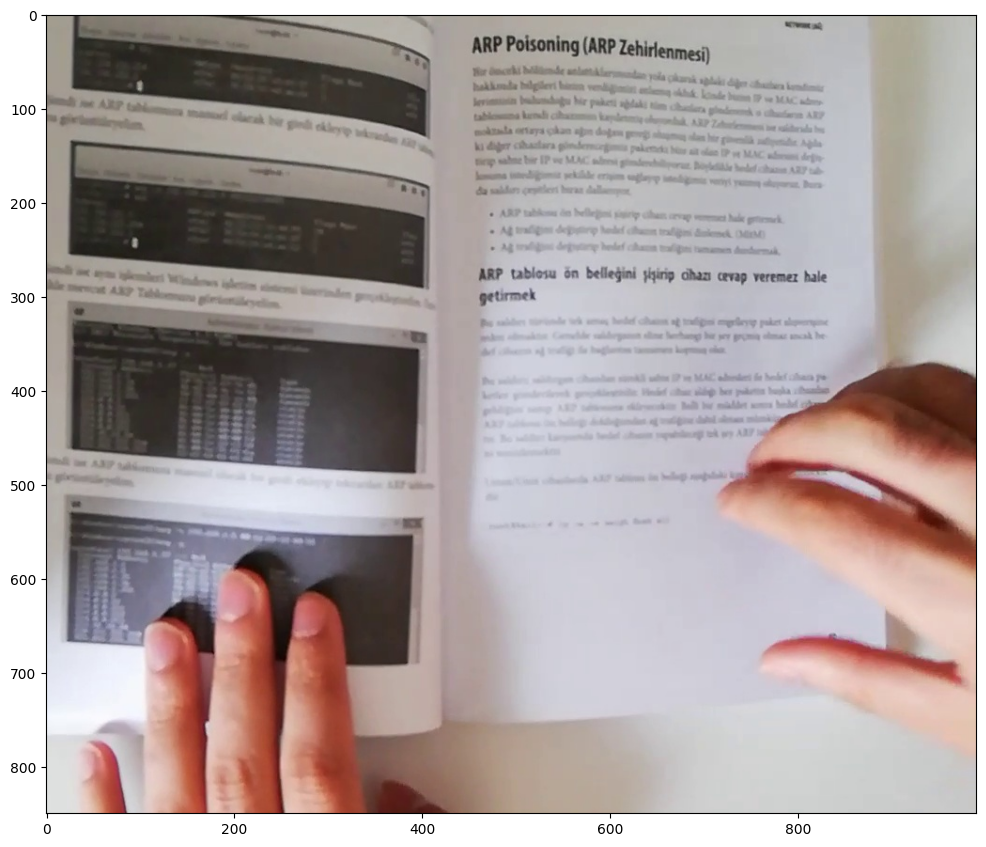

In [ ]:
img = Image.open(path_to_training_images+'/'+random_image)
plt.figure(figsize=(12,12))
img = img.crop((90, 450, 1080, 1300))
plt.imshow(img)
plt.show()

## Speech-to-Text

### SpeechT5

https://huggingface.co/docs/transformers/en/model_doc/speecht5

https://huggingface.co/blog/speecht5

https://huggingface.co/learn/audio-course/en/chapter6/tts_datasets

In [ ]:
!pip install datasets

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 491.2/491.2 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 12.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.9/183.9 kB 17.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 143.5/143.5 kB 13.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.8/194.8 kB 19.1 MB/s eta 0:00:00
  Attempting uninstall: fsspec
    Found existing installation: fsspec 2025.3.2
    Uninstalling fsspec-2025.3.2:
      Successfully uninstalled fsspec-2025.3.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gcsfs 2025.3.2 requires fsspec==2025.3.2, but you have fsspec 2024.12.0 which is incompatible.


In [ ]:
from transformers import SpeechT5Processor, SpeechT5ForTextToSpeech, SpeechT5HifiGan, set_seed, SpeechT5Tokenizer
from datasets import load_dataset

if not os.path.exists("drive/MyDrive/project_4/speech_to_text"):
  processor = SpeechT5Processor.from_pretrained("microsoft/speecht5_tts")
  model = SpeechT5ForTextToSpeech.from_pretrained("microsoft/speecht5_tts")
  vocoder = SpeechT5HifiGan.from_pretrained("microsoft/speecht5_hifigan")

  model.save_pretrained("drive/MyDrive/project_4/speech_to_text/speecht5_model")
  processor.save_pretrained("drive/MyDrive/project_4/speech_to_text/speecht5_processor")
  vocoder.save_pretrained("drive/MyDrive/project_4/speech_to_text/speecht5_vocoder")

else:
  processor = SpeechT5Processor.from_pretrained("drive/MyDrive/project_4/speech_to_text/speecht5_processor")
  model = SpeechT5ForTextToSpeech.from_pretrained("drive/MyDrive/project_4/speech_to_text/speecht5_model")
  vocoder = SpeechT5HifiGan.from_pretrained("drive/MyDrive/project_4/speech_to_text/speecht5_vocoder")

In [ ]:
## generic audio dataset with (1,512) vector audio embeddings
dataset = load_dataset("Matthijs/cmu-arctic-xvectors", split="validation")

print(f"Dataset keys: {dataset[0].keys()}") ## you can note that there is no 'text' or 'raw text' to compare the audio with

README.md:   0%|          | 0.00/1.01k [00:00<?, ?B/s]

cmu-arctic-xvectors.py:   0%|          | 0.00/1.36k [00:00<?, ?B/s]

Xet Storage is enabled for this repo, but the 'hf_xet' package is not installed. Falling back to regular HTTP download. For better performance, install the package with: `pip install huggingface_hub[hf_xet]` or `pip install hf_xet`


0000.parquet:   0%|          | 0.00/21.3M [00:00<?, ?B/s]

Generating validation split:   0%|          | 0/7931 [00:00<?, ? examples/s]

dict_keys(['filename', 'xvector'])

In [ ]:
## text to speech
inputs = processor(text=genesis1_response[:550], return_tensors="pt")
speaker_embeddings = torch.tensor(dataset[7306]["xvector"]).unsqueeze(0)

# generate speech
speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

In [ ]:
import soundfile as sf
from IPython.display import Audio

In [ ]:
sf.write(f"genesis1_tts_generic.wav", speech.numpy(), samplerate=16000)

In [ ]:
Audio(f"genesis1_tts_generic.wav", autoplay=False)

In [ ]:
## better audio dataset to test with
dataset = load_dataset("VladislavKaryukin/AmericanEnglishTTS", split='train')

README.md:   0%|          | 0.00/721 [00:00<?, ?B/s]

train-00000-of-00001.parquet:   0%|          | 0.00/479M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/3837 [00:00<?, ? examples/s]

In [ ]:
for i in range(len(dataset[5:10]['audio'])):
  sf.write(f'tts_english_{i}.wav', dataset[i]['audio']['array'], samplerate=dataset[i]['audio']['sampling_rate'])

  display(Audio(f'tts_english_{i}.wav', autoplay=False))

In [ ]:
from speechbrain.pretrained import EncoderClassifier
import torchaudio

## these lines create x-vector embeddings for the audio file that is provided
## without the x-vector embeddings, the SpeechT5 model will not work because the matrices will not be compatable for mulitiplication

# Load pre-trained x-vector model
classifier = EncoderClassifier.from_hparams(source="speechbrain/spkrec-xvect-voxceleb", savedir="tmp")

# Load your audio file
signal, fs = torchaudio.load("tts_english_0.wav")

# Extract x-vector
xvector = classifier.encode_batch(signal)

DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _speechbrain_save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _speechbrain_load
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for load
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _recover
<ipython-input-48-ad8a0959e441>:1: UserWarning: Module 'speechbrain.pretrained' was deprecated, redirecting to 'speechbrain.inference'. Please update your script. This is a change from SpeechBrain 1.0. See: https://github.com/speechbrain/speechbrain/releases/tag/v1.0.0
  from speechbrain.pretrained import EncoderClassifier
INFO:speechbrain.utils.fetching:Fetch hyperparams.yaml: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached


hyperparams.yaml:   0%|          | 0.00/2.04k [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/hyperparams.yaml' -> '/content/tmp/hyperparams.yaml'
INFO:speechbrain.utils.fetching:Fetch custom.py: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for _save
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint load hook for _load
DEBUG:speechbrain.utils.checkpoints:Registered parameter transfer hook for _load
/usr/local/lib/python3.11/dist-packages/speechbrain/utils/autocast.py:188: FutureWarning: `torch.cuda.amp.custom_fwd(args...)` is deprecated. Please use `torch.amp.custom_fwd(args..., device_type='cuda')` instead.
  wrapped_fwd = torch.cuda.amp.custom_fwd(fwd, cast_inputs=cast_inputs)
DEBUG:speechbrain.utils.checkpoints:Registered checkpoint save hook for save
DEBUG:speechbrain.u

embedding_model.ckpt:   0%|          | 0.00/16.9M [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/embedding_model.ckpt' -> '/content/tmp/embedding_model.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["embedding_model"] = /content/tmp/embedding_model.ckpt
INFO:speechbrain.utils.fetching:Fetch mean_var_norm_emb.ckpt: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached


mean_var_norm_emb.ckpt:   0%|          | 0.00/3.20k [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/mean_var_norm_emb.ckpt' -> '/content/tmp/mean_var_norm_emb.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["mean_var_norm_emb"] = /content/tmp/mean_var_norm_emb.ckpt
INFO:speechbrain.utils.fetching:Fetch classifier.ckpt: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached


classifier.ckpt:   0%|          | 0.00/15.9M [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/classifier.ckpt' -> '/content/tmp/classifier.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["classifier"] = /content/tmp/classifier.ckpt
INFO:speechbrain.utils.fetching:Fetch label_encoder.txt: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached


label_encoder.txt:   0%|          | 0.00/129k [00:00<?, ?B/s]

DEBUG:speechbrain.utils.fetching:Fetch: Local file found, creating symlink '/root/.cache/huggingface/hub/models--speechbrain--spkrec-xvect-voxceleb/snapshots/56895a2df401be4150a159f3a1c653f00051d477/label_encoder.txt' -> '/content/tmp/label_encoder.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["label_encoder"] = /content/tmp/label_encoder.ckpt
INFO:speechbrain.utils.parameter_transfer:Loading pretrained files for: embedding_model, mean_var_norm_emb, classifier, label_encoder
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): embedding_model -> /content/tmp/embedding_model.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): mean_var_norm_emb -> /content/tmp/mean_var_norm_emb.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): classifier -> /content/tmp/classifier.ckpt
DEBUG:speechbrain.utils.parameter_transfer:Redirecting (loading from local path): label_e

In [ ]:
inputs = processor(text=genesis1_response[:600], return_tensors="pt")

speaker_embeddings = torch.tensor(xvector[0][0].tolist()).unsqueeze(0)

print(f'Speaker embeddings dtype: {speaker_embeddings.dtype}')
print(f'Speaker embeddings shape: {speaker_embeddings.shape}')
inputs['input_ids'] = inputs['input_ids'].to(torch.long)

# generate speech
speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

Speaker embeddings dtype: torch.float32
Speaker embeddings shape: torch.Size([1, 512])


In [ ]:
sf.write("genesis1_tts_better.wav", speech.numpy(), samplerate=16000)
Audio("genesis1_tts_better.wav", autoplay=False)

### Canto 1 Example

In [ ]:
canto1_response = client.models.generate_content(
    model="gemini-1.5-flash",
    contents=[canto1, "Extract the text that is on the open page of the image. If a hand is partially covering a page, disregard that page. Do not extraploate of add any extra text in the response."])
print(canto1_response.text)

Canto I
E'en* such made me that beast withouten peace, 10
Which, coming on against me by degrees,
Thrust me back thither where the sun is silent.
While I was rushing downward to the lowland,
Before mine eyes did one present himself,
Who seemed from long-continued silence hoarse.
When I beheld him in the desert vast,
"Have pity on me,"II unto him I cried,
"Whiche'er thou art, or shade or real man!"
He answered me: "Not man; man once I was, 12
And both my parents were of Lombardy,
And Mantuans by country both of them.
Sub Julio was I born, though it was late,
And lived at Rome under the good Augustus,
During the time of false and lying gods.
A Poet was I, and I sang that just
Son of Anchises, who came forth from Troy,
After that Ilion** the superb was burned.
But thou, why goest thou back to such annoyance?
Why climb'st thou not the Mount Delectable,"
Which is the source and cause of every joy?'
"Now, art thou that Virgilius13 and that fountain
Which spreads abroad so wide a river of spe

In [ ]:
canto1_response = canto1_response.text[:-99]

In [ ]:
## text to speech
inputs = processor(text=canto1_response[:600], return_tensors="pt")
speaker_embeddings = torch.tensor(xvector[0][0].tolist()).unsqueeze(0)

# generate speech
speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

In [ ]:
sf.write("canto1_tts_better.wav", speech.numpy(), samplerate=16000)
Audio("canto1_tts_better.wav", autoplay=False)

### Turkish Audio

In [ ]:
turkish_audio = load_dataset("ysdede/khanacademy-turkish", split='train')
len(turkish_audio)

README.md:   0%|          | 0.00/116k [00:00<?, ?B/s]

train-00000-of-00003.parquet:   0%|          | 0.00/392M [00:00<?, ?B/s]

train-00001-of-00003.parquet:   0%|          | 0.00/398M [00:00<?, ?B/s]

train-00002-of-00003.parquet:   0%|          | 0.00/397M [00:00<?, ?B/s]

test-00000-of-00001.parquet:   0%|          | 0.00/62.7M [00:00<?, ?B/s]

Generating train split:   0%|          | 0/25741 [00:00<?, ? examples/s]

Generating test split:   0%|          | 0/1355 [00:00<?, ? examples/s]

25741

In [ ]:
turkish_audio[0]

{'transcription': 'Bunu belirleyen iki dinamik var birincisi litre başına sabit maliyetimizi Asgariye düşürebilmek için mümkün olduğunca çok üretmek isteriz.',
 'audio': {'path': 'chunk_20.opus',
  'array': array([-1.67695059e-11, -3.15520492e-11, -6.77465861e-11, ...,
         -1.57041475e-02,  1.22356256e-02, -7.41708232e-03]),
  'sampling_rate': 16000}}

In [ ]:
sf.write('tts_turkish_1.wav', turkish_audio[0]['audio']['array'], samplerate=16000)

In [ ]:
Audio('tts_turkish_1.wav', autoplay=False)

In [ ]:
## do the same thing as with the English audio dataset up above

# Load pre-trained x-vector model
classifier = EncoderClassifier.from_hparams(source="speechbrain/spkrec-xvect-voxceleb", savedir="tmp")

# Load your audio file
signal, fs = torchaudio.load("tts_turkish_1.wav")

# Extract x-vector
xvector_turkish = classifier.encode_batch(signal)

INFO:speechbrain.utils.fetching:Fetch hyperparams.yaml: Using symlink found at '/content/tmp/hyperparams.yaml'
INFO:speechbrain.utils.fetching:Fetch custom.py: Fetching from HuggingFace Hub 'speechbrain/spkrec-xvect-voxceleb' if not cached
DEBUG:speechbrain.utils.parameter_transfer:Collecting files (or symlinks) for pretraining in tmp.
INFO:speechbrain.utils.fetching:Fetch embedding_model.ckpt: Using symlink found at '/content/tmp/embedding_model.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["embedding_model"] = /content/tmp/embedding_model.ckpt
INFO:speechbrain.utils.fetching:Fetch mean_var_norm_emb.ckpt: Using symlink found at '/content/tmp/mean_var_norm_emb.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local path in self.paths["mean_var_norm_emb"] = /content/tmp/mean_var_norm_emb.ckpt
INFO:speechbrain.utils.fetching:Fetch classifier.ckpt: Using symlink found at '/content/tmp/classifier.ckpt'
DEBUG:speechbrain.utils.parameter_transfer:Set local 

In [ ]:
inputs = processor(text=random_image_response[:600], return_tensors="pt")

speaker_embeddings = torch.tensor(xvector_turkish[0][0].tolist()).unsqueeze(0)

# speaker_embeddings = torch.Tensor.double(speaker_embeddings)
print(speaker_embeddings.dtype)
print(speaker_embeddings.shape)
inputs['input_ids'] = inputs['input_ids'].to(torch.long)

# generate speech
speech = model.generate(inputs["input_ids"], speaker_embeddings=speaker_embeddings, vocoder=vocoder)

torch.float32
torch.Size([1, 512])
torch.int64
torch.Size([1, 596])


tensor([-0.0007, -0.0006, -0.0007,  ..., -0.0007, -0.0008, -0.0009])

In this case, 'better' by no-means means that the text-to-speech audio will be better because it was using better quality audio files.

In this case the interpretability is quite poor for Turkish speakers/listeners.

In [ ]:
sf.write("turkish_tts_better.wav", speech.numpy(), samplerate=16000)
Audio("turkish_tts_better.wav", autoplay=False)

In [ ]:
random_image_response

'ARP Poisoning (ARP Zehirlenmesi)\n\nBirinci bilgisayardan gönderilenlere ek olarak, diğer cihazlar kendilerine\nhakkında bilgileri yanlış ağ kapsamında iletilir. Kısaca bir saldırgan ARP\ntablosunda ortaya çıkan ağ paketleri arasında ARP isteklerini değiştirerek\nkendini başka bir cihaz gibi gösterebilir. Bu durum saldırganın ağ trafiğini\nkışa sahip IP ve MAC adresine sahte paketler gönderebilmesine, Ağ trafiğini\ndiğer cihazlara yönlendirerek ağ güvenliğini tehdit etmesine neden olur. Bu\ndurum saldırganın hızıra ulaşmasını engeller. Bununla birlikte ARP\nsaldırısının çeşitli yöntemleri vardır.\n\nARP tablosunu ön belleğinden çıkarmak gerek.\nAğ trafiğini değiştirerek hedef trafiğini tamamen durdurmak.\nAğ trafiğini değiştirerek hedef trafiğini yavaşlatmak.\n\nARP tablosu ön belleğini şişirip cihazı cevap veremez hale\ngetirmek'

Please see the Sesame_Audio notebook for next part of project